In [ ]:
!pip uninstall tensorflow


In [ ]:
!pip install tensorflow

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import Dropout
from sklearn.utils import resample
from tensorflow.keras.applications import VGG16
from sklearn.metrics import classification_report, confusion_matrix
import pandas as pd






Epoch 1/10
310/310 [==============================] - 345s 1s/step - loss: 4.3944 - accuracy: 0.1380 - val_loss: 3.9919 - val_accuracy: 0.1623
Epoch 2/10
310/310 [==============================] - 333s 1s/step - loss: 3.9789 - accuracy: 0.1497 - val_loss: 3.9614 - val_accuracy: 0.1623
Epoch 3/10
310/310 [==============================] - 327s 1s/step - loss: 3.9518 - accuracy: 0.1493 - val_loss: 4.0583 - val_accuracy: 0.1623
Epoch 4/10
310/310 [==============================] - 326s 1s/step - loss: 3.8668 - accuracy: 0.1541 - val_loss: 4.0415 - val_accuracy: 0.1575
Epoch 5/10
310/310 [==============================] - 330s 1s/step - loss: 3.5562 - accuracy: 0.1831 - val_loss: 4.1611 - val_accuracy: 0.1266
Epoch 6/10
310/310 [==============================] - 338s 1s/step - loss: 3.0173 - accuracy: 0.2828 - val_loss: 4.8377 - val_accuracy: 0.1201
Epoch 7/10
310/310 [==============================] - 335s 1s/step - loss: 2.3933 - accuracy: 0.4026 - val_loss: 5.9837 - val_accuracy: 0.1088

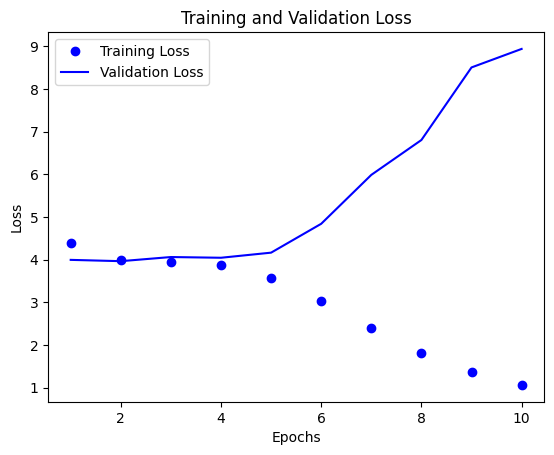

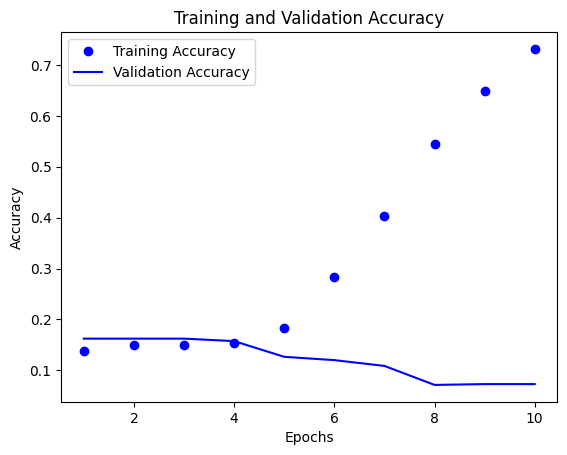

In [ ]:
#using CNN without regularization

# Step 1: Data Collection and Preparation
data_directory = '/content/drive/MyDrive/256x256'  # Replace with the actual path to your dataset folder
image_size = (256,256)  # Set the desired image size
X = []
y = []

for tumor_type in os.listdir(data_directory):
    tumor_type_directory = os.path.join(data_directory, tumor_type)
    if not os.path.isdir(tumor_type_directory):  # Skip non-directory files
        continue
    for image_file in os.listdir(tumor_type_directory):
        image_path = os.path.join(tumor_type_directory, image_file)
        if not os.path.isfile(image_path):  # Skip non-file items
            continue
        try:
            image = Image.open(image_path).convert('RGB')
            image = image.resize(image_size)
            X.append(np.array(image))
            y.append(tumor_type)
        except Exception as e:
            print(f"Error processing image: {image_path}")
            print(e)

# Step 2: Preprocessing
X = np.array(X)
y = np.array(y)

# Step 3: Label Encoding
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Step 4: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 5: Create and Configure Image Data Generator
data_generator = ImageDataGenerator(rescale=1.0 / 255.0)

# Step 6: Model Creation
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(image_size[0], image_size[1], 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dense(len(label_encoder.classes_), activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Step 7: Model Training using Image Data Generator
batch_size = 8  # Decrease the batch size
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)


history = model.fit(train_generator, epochs=10, steps_per_epoch=len(X_train) // batch_size,
                    validation_data=test_generator, validation_steps=len(X_test) // batch_size)

# Step 8: Training Loss and Accuracy
training_loss = history.history['loss']
training_accuracy = history.history['accuracy']

# Step 9: Validation Loss and Accuracy
validation_loss = history.history['val_loss']
validation_accuracy = history.history['val_accuracy']

# Step 10: Plot Loss and Accuracy Curves
epochs = range(1, len(training_loss) + 1)

plt.plot(epochs, training_loss, 'bo', label='Training Loss')
plt.plot(epochs, validation_loss, 'b', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.plot(epochs, training_accuracy, 'bo', label='Training Accuracy')
plt.plot(epochs, validation_accuracy, 'b', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


Epoch 1/10
622/622 [==============================] - 241s 338ms/step - loss: 0.0011 - accuracy: 0.9996 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 2/10
622/622 [==============================] - 202s 324ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 3/10
622/622 [==============================] - 201s 323ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 4/10
622/622 [==============================] - 200s 321ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 5/10
622/622 [==============================] - 204s 328ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 6/10
622/622 [==============================] - 208s 334ms/step - loss: 0.0000e+00 - accuracy: 1.0000 - val_loss: 0.0000e+00 - val_accuracy: 1.0000
Epoch 7/10
622/622 [==============================] - 207s 333ms/step - loss: 0.

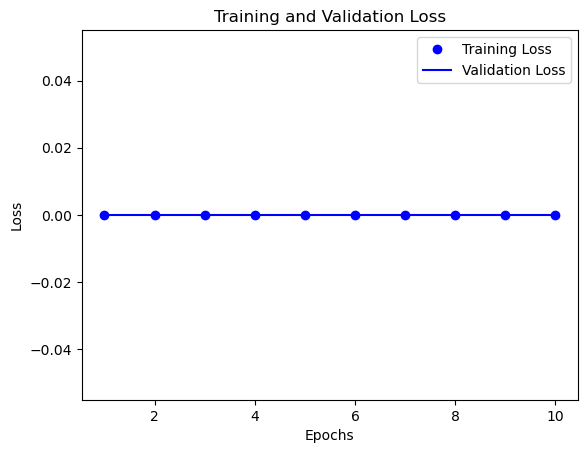

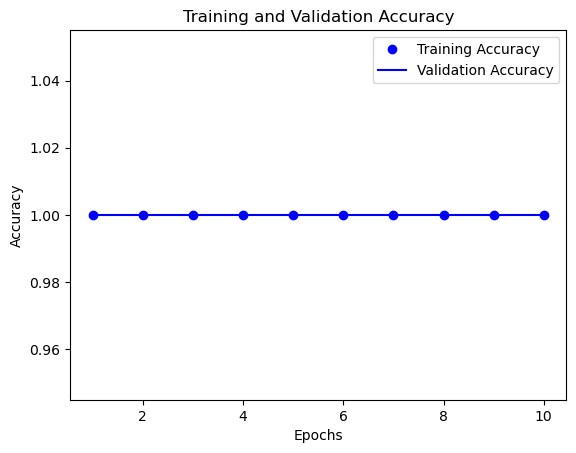

In [11]:
#using CNN only for tumor differentiation

# Step 1: Data Collection and Preparation
data_directory = 'C:\\Users\\Maximilian\\Desktop\\data\\256x256'  # Replace with the actual path to your dataset folder
image_size = (256, 256)  # Set the desired image size
X = []
y = []

for tumor_type_directory in os.listdir(data_directory):
    tumor_type_path = os.path.join(data_directory, tumor_type_directory)
    if not os.path.isdir(tumor_type_path):  # Skip non-directory items
        continue
    for image_file in os.listdir(tumor_type_path):
        image_path = os.path.join(tumor_type_path, image_file)
        if not os.path.isfile(image_path):  # Skip non-file items
            continue
        try:
            image = Image.open(image_path).convert('RGB')
            image = image.resize(image_size)
            X.append(np.array(image))
            # Assuming that images containing a tumor are labeled as positive (1) and those without a tumor as negative (0)
            if 'tumor' in image_file.lower():
                y.append(1)
            else:
                y.append(0)
        except Exception as e:
            print(f"Error processing image: {image_path}")
            print(e)

# Step 2: Preprocessing
X = np.array(X)
y = np.array(y)

# Step 3: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Create and Configure Image Data Generator
data_generator = ImageDataGenerator(rescale=1.0 / 255.0)

# Step 5: Model Creation
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(image_size[0], image_size[1], 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dense(1, activation='sigmoid'))  # Single output neuron with sigmoid activation for binary classification

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Step 6: Model Training using Image Data Generator
batch_size = 4  # Adjust the batch size if needed
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)

model.fit(train_generator, epochs=10, steps_per_epoch=len(X_train) // batch_size,
          validation_data=test_generator, validation_steps=len(X_test) // batch_size)



# Step 7: Model Training using Image Data Generator
batch_size = 8  # Decrease the batch size
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)


history = model.fit(train_generator, epochs=10, steps_per_epoch=len(X_train) // batch_size,
                    validation_data=test_generator, validation_steps=len(X_test) // batch_size)

# Step 8: Training Loss and Accuracy
training_loss = history.history['loss']
training_accuracy = history.history['accuracy']

# Step 9: Validation Loss and Accuracy
validation_loss = history.history['val_loss']
validation_accuracy = history.history['val_accuracy']

# Step 10: Plot Loss and Accuracy Curves
epochs = range(1, len(training_loss) + 1)

plt.plot(epochs, training_loss, 'bo', label='Training Loss')
plt.plot(epochs, validation_loss, 'b', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.plot(epochs, training_accuracy, 'bo', label='Training Accuracy')
plt.plot(epochs, validation_accuracy, 'b', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


Epoch 1/30
310/310 [==============================] - 60s 158ms/step - loss: 4.5671 - accuracy: 0.1267 - val_loss: 4.1794 - val_accuracy: 0.1526
Epoch 2/30
310/310 [==============================] - 50s 163ms/step - loss: 4.1404 - accuracy: 0.1444 - val_loss: 3.9710 - val_accuracy: 0.1526
Epoch 3/30
310/310 [==============================] - 48s 155ms/step - loss: 4.0980 - accuracy: 0.1505 - val_loss: 3.9722 - val_accuracy: 0.1526
Epoch 4/30
310/310 [==============================] - 49s 159ms/step - loss: 4.0703 - accuracy: 0.1517 - val_loss: 3.9118 - val_accuracy: 0.1526
Epoch 5/30
310/310 [==============================] - 50s 160ms/step - loss: 4.0692 - accuracy: 0.1509 - val_loss: 3.9130 - val_accuracy: 0.1542
Epoch 6/30
310/310 [==============================] - 50s 161ms/step - loss: 4.0287 - accuracy: 0.1529 - val_loss: 3.9052 - val_accuracy: 0.1526
Epoch 7/30
310/310 [==============================] - 48s 155ms/step - loss: 4.0175 - accuracy: 0.1521 - val_loss: 3.9249 - val_ac

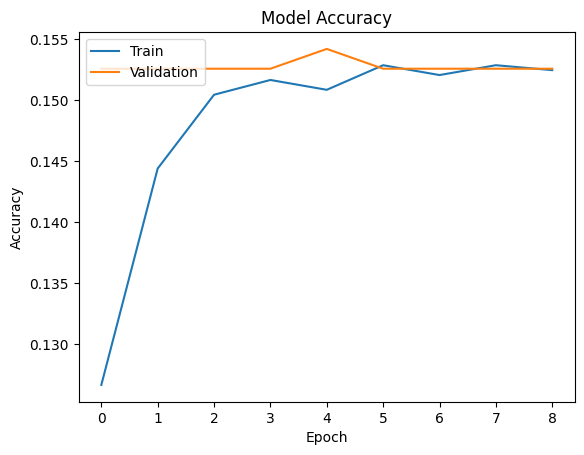

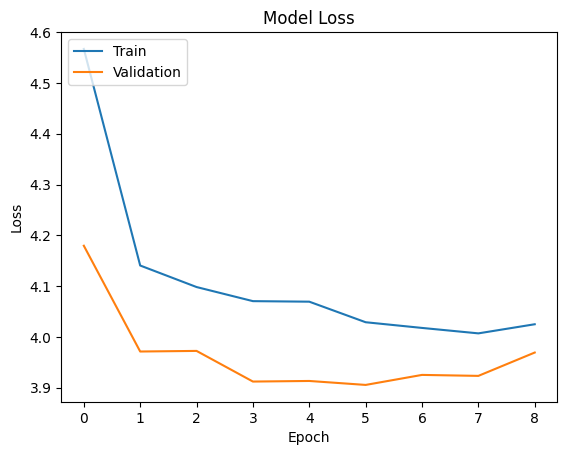

In [ ]:
#using CNN

# Step 1: Data Collection and Preparation
data_directory = '/content/drive/MyDrive/256x256'  # Replace with the actual path to your dataset folder
image_size = (256, 256)  # Set the desired image size
X = []
y = []

class_names = sorted(os.listdir(data_directory))
num_classes = len(class_names)

for class_index, class_name in enumerate(class_names):
    class_directory = os.path.join(data_directory, class_name)
    if not os.path.isdir(class_directory):  # Skip non-directory items
        continue
    for image_file in os.listdir(class_directory):
        image_path = os.path.join(class_directory, image_file)
        if not os.path.isfile(image_path):  # Skip non-file items
            continue
        try:
            image = Image.open(image_path).convert('RGB')
            image = image.resize(image_size)
            X.append(np.array(image))
            y.append(class_index)
        except Exception as e:
            print(f"Error processing image: {image_path}")
            print(e)

# Step 2: Preprocessing
X = np.array(X)
y = np.array(y)

# Step 3: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Create and Configure Image Data Generator
data_generator = ImageDataGenerator(
    rescale=1.0 / 255.0,
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    vertical_flip=True
)

# Step 5: Model Creation
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(image_size[0], image_size[1], 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))  # Adding Dropout regularization
model.add(Dense(num_classes, activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Step 6: Model Training using Image Data Generator
batch_size = 8
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)

early_stopping = EarlyStopping(monitor='val_loss', patience=3)  # Early stopping to prevent overfitting

history = model.fit(train_generator, epochs=30, steps_per_epoch=len(X_train) // batch_size,
                    validation_data=test_generator, validation_steps=len(X_test) // batch_size,
                    callbacks=[early_stopping])

# Plotting training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plotting training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

Epoch 1/4
311/311 [==============================] - 1405s 4s/step - loss: 4.7920 - accuracy: 0.1385 - val_loss: 4.6924 - val_accuracy: 0.1575
Epoch 2/4
311/311 [==============================] - 1305s 4s/step - loss: 4.6322 - accuracy: 0.1510 - val_loss: 4.5666 - val_accuracy: 0.1575
Epoch 3/4
311/311 [==============================] - 1425s 5s/step - loss: 4.5173 - accuracy: 0.1514 - val_loss: 4.4613 - val_accuracy: 0.1575
Epoch 4/4
311/311 [==============================] - 1297s 4s/step - loss: 4.4199 - accuracy: 0.1518 - val_loss: 4.3708 - val_accuracy: 0.1575


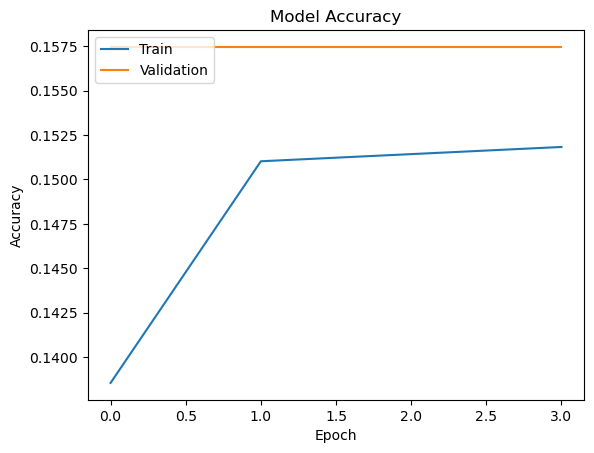

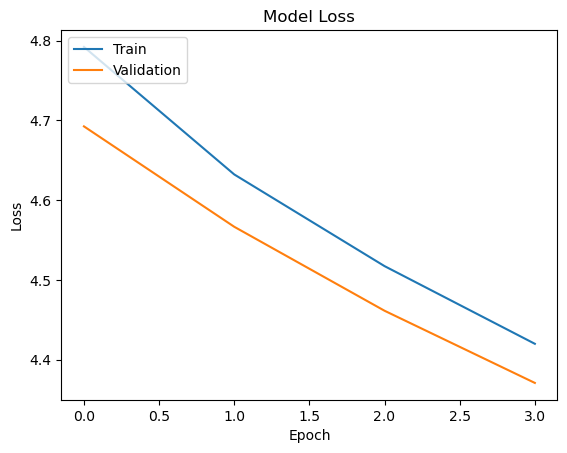

In [24]:
# using VGG16

# Step 1: Data Collection and Preparation
data_directory = 'C:\\Users\\Maximilian\\Desktop\\data\\256x256'  # Replace with the actual path to your dataset folder
image_size = (256, 256)  # Set the desired image size
X = []
y = []

class_names = sorted(os.listdir(data_directory))
num_classes = len(class_names)

for class_index, class_name in enumerate(class_names):
    class_directory = os.path.join(data_directory, class_name)
    if not os.path.isdir(class_directory):  # Skip non-directory items
        continue
    for image_file in os.listdir(class_directory):
        image_path = os.path.join(class_directory, image_file)
        if not os.path.isfile(image_path):  # Skip non-file items
            continue
        try:
            image = Image.open(image_path).convert('RGB')
            image = image.resize(image_size)
            X.append(np.array(image))
            y.append(class_index)
        except Exception as e:
            print(f"Error processing image: {image_path}")
            print(e)

# Step 2: Preprocessing
X = np.array(X)
y = np.array(y)

# Step 3: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Create and Configure Image Data Generator
data_generator = ImageDataGenerator(
    rescale=1.0 / 255.0,
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    vertical_flip=True
)

# Step 5: Load the pre-trained VGG16 model without the top classification layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(image_size[0], image_size[1], 3))

# Freeze the weights of the base model
base_model.trainable = False

# Step 6: Build the model architecture on top of the base model
model = Sequential()
model.add(base_model)
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Step 7: Model Training using Image Data Generator
batch_size = 8
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)

early_stopping = EarlyStopping(monitor='val_loss', patience=3)  # Early stopping to prevent overfitting

history = model.fit(train_generator, epochs=4, steps_per_epoch=len(X_train) // batch_size,
                    validation_data=test_generator, validation_steps=len(X_test) // batch_size,
                    callbacks=[early_stopping])

# Plotting training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plotting training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


1/1 [==============================] - 0s 473ms/step


C:\Users\Maximilian\AppData\Local\Temp\ipykernel_11340\280366213.py:56: RuntimeWarning: invalid value encountered in cast
  cam = cv2.applyColorMap(np.uint8(255 * weights_np), cv2.COLORMAP_JET)


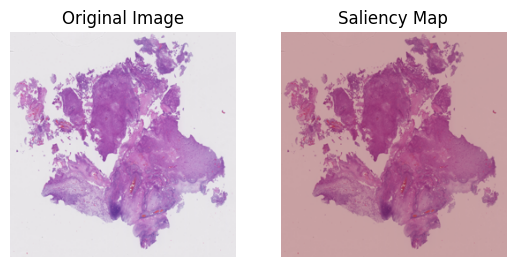

In [17]:
import cv2
import tensorflow as tf
import numpy as np
from PIL import Image

def generate_gradcam(model, image):
    # Convert the image to numpy array and reshape it
    image_np = np.array(image)
    image_np = np.reshape(image_np, (1,) + image_np.shape)

    # Convert the image to a tensor
    image_tensor = tf.convert_to_tensor(image_np)

    # Record operations for automatic differentiation
    with tf.GradientTape() as tape:
        inputs = image_tensor
        tape.watch(inputs)
        conv_output = model(inputs, training=False)
        predictions = model.predict(inputs)

        # Get the index of the predicted class
        predicted_class = np.argmax(predictions)

        # Get the output tensor corresponding to the predicted class
        output = conv_output[0, predicted_class]

    # Calculate the gradients of the predicted class with respect to the output feature map
    gradients = tape.gradient(output, conv_output)

    # Get the channel-wise importance weights by averaging the gradients
    weights = tf.reduce_mean(gradients, axis=(0, 1))

    # Transpose the weights tensor to match the target size format
    weights = tf.transpose(weights)

    # Add an extra dimension to the weights tensor
    weights = tf.expand_dims(weights, axis=0)

    # Reshape the weights tensor to have 3 dimensions
    #weights = tf.reshape(weights, (1, weights.shape[1], weights.shape[2], 1))
    #weights = tf.reshape(weights, (1, weights.shape[0], weights.shape[1], 1))
    weights = tf.reshape(weights, (1, *weights.shape, 1))


    # Resize the weights to match the input image size while preserving aspect ratio
    target_size = (image_np.shape[1], image_np.shape[2])
    weights = tf.image.resize(weights, target_size, preserve_aspect_ratio=True)

    # Normalize the weights between 0 and 1
    weights = (weights - tf.reduce_min(weights)) / (tf.reduce_max(weights) - tf.reduce_min(weights))

    # Convert the weights tensor to a numpy array
    weights_np = weights.numpy()

    # Apply colormap to the weights to visualize the saliency map
    cam = cv2.applyColorMap(np.uint8(255 * weights_np), cv2.COLORMAP_JET)

    # Overlay the saliency map on the original image
    saliency_map = cv2.addWeighted(np.uint8(image), 0.7, cam, 0.3, 0)

    return saliency_map

# Assuming you have an image 'input_image.jpg' for which you want to generate the saliency map
input_image_path = r'C:\Users\Maximilian\Desktop\data\256x256\Glioblastoma, IDH-wildtype\a194f783-357f-11eb-9ee2-001a7dda7111.png'
input_image = Image.open(input_image_path).convert('RGB')

# Generate the saliency map using GradCAM
saliency_map = generate_gradcam(model, input_image)

# Display the original image and saliency map
plt.subplot(1, 2, 1)
plt.imshow(input_image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(saliency_map)
plt.title('Saliency Map')
plt.axis('off')

plt.show()


<Figure size 640x480 with 0 Axes>

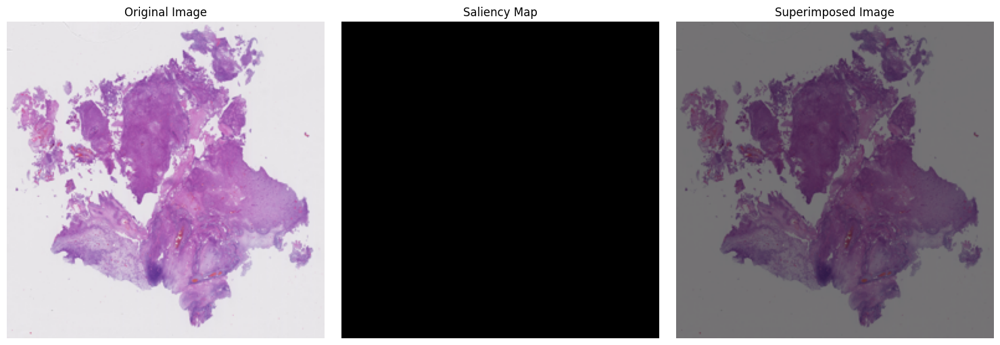

In [13]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import cv2

image_size = (256, 256)  # Set the desired image size

# Load and preprocess the image
image_path = 'C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png'
image = Image.open(image_path).convert('RGB')
image = image.resize(image_size)
image_np = np.array(image) / 255.0

# Reshape the image to have a batch dimension
image_np = np.reshape(image_np, (1,) + image_np.shape)

# Obtain the gradients of the predicted class with respect to the input image
with tf.GradientTape() as tape:
    inputs = tf.convert_to_tensor(image_np, dtype=tf.float32)
    tape.watch(inputs)
    predictions = model(inputs)
    predicted_class = tf.argmax(predictions[0])
    predicted_output = predictions[:, predicted_class]

gradients = tape.gradient(predicted_output, inputs)[0]

# Normalize the gradients using NumPy
gradients = (gradients - np.min(gradients)) / (np.max(gradients) - np.min(gradients))

# Superimpose the heatmap on the original image
heatmap = tf.image.resize(gradients, image_size)
heatmap = tf.keras.preprocessing.image.array_to_img(heatmap)
heatmap_np = np.array(heatmap, dtype=np.float32)  # Convert heatmap to float32

# Convert image_np to uint8
image_np_uint8 = (image_np * 255).astype(np.uint8)

# Convert heatmap_np to uint8
heatmap_np_uint8 = (heatmap_np * 255).astype(np.uint8)

# Create the superimposed image
superimposed = cv2.addWeighted(image_np_uint8[0], 0.5, heatmap_np_uint8, 0.5, 0.0)

# Plot the original image, heatmap, and superimposed image side by side
plt.figure()
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(image)
axes[0].set_title('Original Image')
axes[0].axis('off')

axes[1].imshow(gradients)
axes[1].set_title('Saliency Map')
axes[1].axis('off')

axes[2].imshow(superimposed)
axes[2].set_title('Superimposed Image')
axes[2].axis('off')

plt.tight_layout()
plt.show()


1/1 [==============================] - 1s 745ms/step


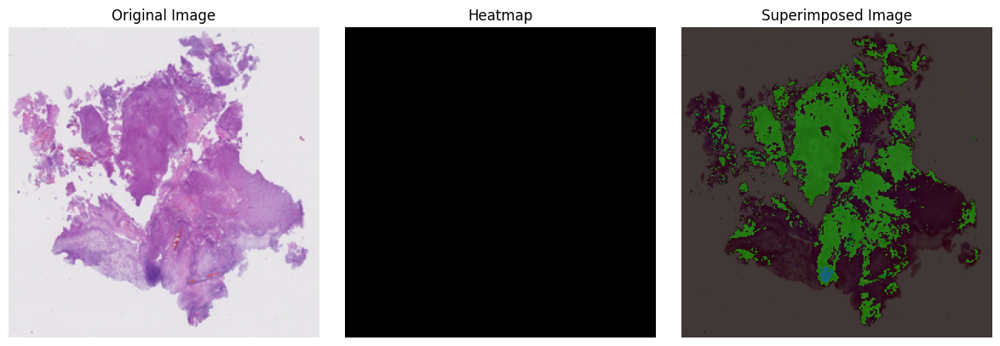

In [23]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions
from tensorflow.keras.models import Model
import tensorflow as tf

# Load the image
image_path = 'C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png'  # Replace with the actual path to your image
img = image.load_img(image_path, target_size=image_size)
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
preprocessed_img_array = preprocess_input(img_array)

# Generate the prediction
predictions = model.predict(preprocessed_img_array)
predicted_class = np.argmax(predictions[0])
predicted_class_name = class_names[predicted_class]

# GradCAM
last_conv_layer = model.get_layer('dense_1')  # Get the last convolutional layer
grad_model = Model(inputs=model.inputs, outputs=(last_conv_layer.output, model.output))

with tf.GradientTape() as tape:
    conv_outputs, predictions = grad_model(preprocessed_img_array)
    loss = predictions[:, predicted_class]

grads = tape.gradient(loss, conv_outputs)
grads = tf.squeeze(grads)  # Remove any singleton dimensions
grads = tf.expand_dims(grads, axis=0)  # Add an extra dimension
pooled_grads = tf.reduce_mean(grads, axis=(0, 1))
heatmap = tf.reduce_mean(tf.multiply(pooled_grads, conv_outputs), axis=-1)


# Normalize the heatmap
heatmap = np.maximum(heatmap, 0)
#heatmap /= np.max(heatmap)
#heatmap = (heatmap - np.min(heatmap)) / (np.max(heatmap) - np.min(heatmap) + 1e-7)
heatmap = (heatmap - np.mean(heatmap)) / (np.std(heatmap) + 1e-7)

# Resize the heatmap to match the image size
heatmap = cv2.resize(heatmap, (img_array.shape[2], img_array.shape[1]))

# Apply heatmap to the original image
#heatmap = cv2.applyColorMap(np.uint8(255 * heatmap), cv2.COLORMAP_JET)
#heatmap = cv2.applyColorMap(np.uint8(255 * heatmap), cv2.COLORMAP_JET)
heatmap = cv2.applyColorMap(np.uint8(256 * heatmap), cv2.COLORMAP_HOT)
superimposed_img = cv2.addWeighted(
    cv2.cvtColor(np.uint8(img_array[0]), cv2.COLOR_RGB2BGR),
    0.5,
    cv2.cvtColor(np.uint8(heatmap), cv2.COLOR_RGB2BGR),
    0.5,
    0
)


# Display the original image, heatmap, and superimposed image
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
ax[0].imshow(img)
ax[0].set_title('Original Image')
ax[0].axis('off')
ax[1].imshow(heatmap)
ax[1].set_title('Heatmap')
ax[1].axis('off')
ax[2].imshow(superimposed_img)
ax[2].set_title('Superimposed Image')
ax[2].axis('off')

plt.tight_layout()
plt.show()


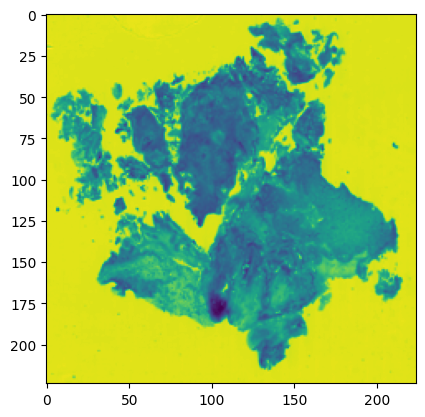

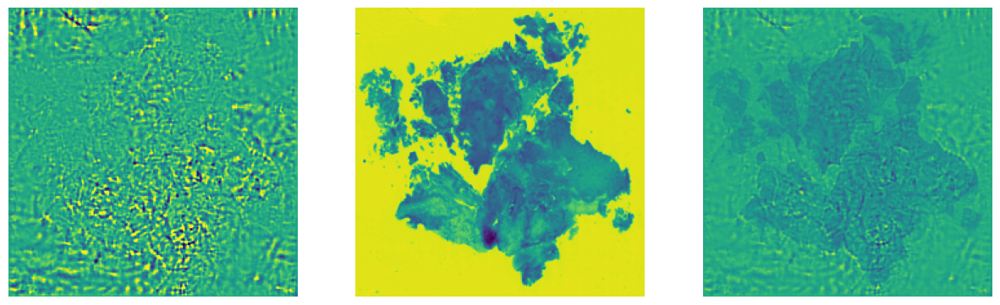

In [47]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

def prep_input(path):
    image = tf.image.decode_png(tf.io.read_file(path))
    image = tf.expand_dims(image, axis=0)
    image = tf.cast(image, tf.float32)
    image = tf.keras.applications.vgg16.preprocess_input(image)
    image = tf.image.resize(image, [224, 224])  # Resize the image to (224, 224)
    return image

def norm_flat_image(img):
    grads_norm = img[:,:,0] + img[:,:,1] + img[:,:,2]
    grads_norm = (grads_norm - tf.reduce_min(grads_norm)) / (tf.reduce_max(grads_norm) - tf.reduce_min(grads_norm))
    return grads_norm

def plot_maps(img1, img2, vmin=0.3, vmax=0.7, mix_val=2):
    f = plt.figure(figsize=(15, 45))
    plt.subplot(1, 3, 1)
    plt.imshow(img1, vmin=vmin, vmax=vmax)
    plt.axis("off")
    plt.subplot(1, 3, 2)
    plt.imshow(img2)
    plt.axis("off")
    plt.subplot(1, 3, 3)
    plt.imshow(img1 * mix_val + img2 / mix_val)
    plt.axis("off")

img_path = 'C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png'  # Replace with the actual path to your image

input_img = prep_input(img_path)

model = tf.keras.applications.VGG16(include_top=True, weights='imagenet')

plt.imshow(norm_flat_image(input_img[0]))

with tf.GradientTape() as tape:
    tape.watch(input_img)
    result = model(input_img)
    max_idx = tf.argmax(result, axis=1)
    max_score = result[0, max_idx[0]]

grads = tape.gradient(max_score, input_img)
plot_maps(norm_flat_image(grads[0]), norm_flat_image(input_img[0]))

plt.show()


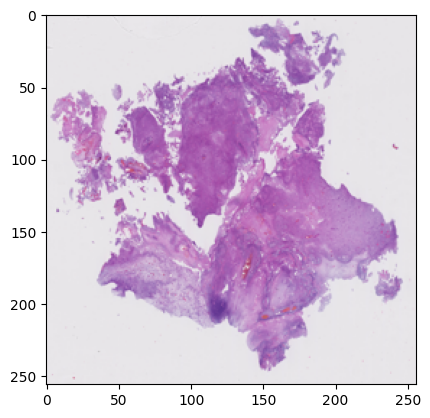

1/1 [==============================] - 1s 1s/step


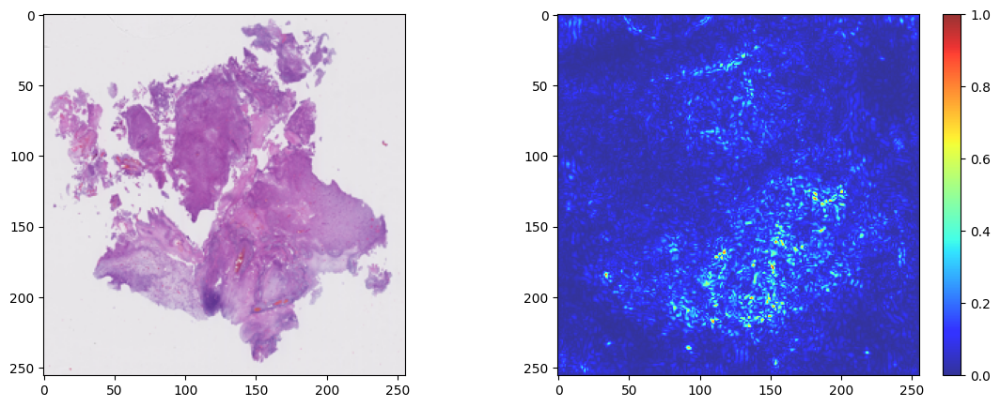

In [9]:
import tensorflow as tf
import tensorflow.keras as keras

import numpy as np
import matplotlib.pyplot as plt

_img = keras.preprocessing.image.load_img('C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png',target_size=(256,256))
plt.imshow(_img)
plt.show()

#preprocess image to get it into the right format for the model
img = keras.preprocessing.image.img_to_array(_img)
img = img.reshape((1, *img.shape))
y_pred = model.predict(img)

images = tf.Variable(img, dtype=float)

with tf.GradientTape() as tape:
    pred = model(images, training=False)
    class_idxs_sorted = np.argsort(pred.numpy().flatten())[::-1]
    loss = pred[0][class_idxs_sorted[0]]
    
grads = tape.gradient(loss, images)

dgrad_abs = tf.math.abs(grads)
dgrad_max_ = np.max(dgrad_abs, axis=3)[0]

## normalize to range between 0 and 1
arr_min, arr_max  = np.min(dgrad_max_), np.max(dgrad_max_)
grad_eval = (dgrad_max_ - arr_min) / (arr_max - arr_min + 1e-18)
fig, axes = plt.subplots(1,2,figsize=(14,5))
axes[0].imshow(_img)
i = axes[1].imshow(grad_eval,cmap="jet",alpha=0.8)
fig.colorbar(i)

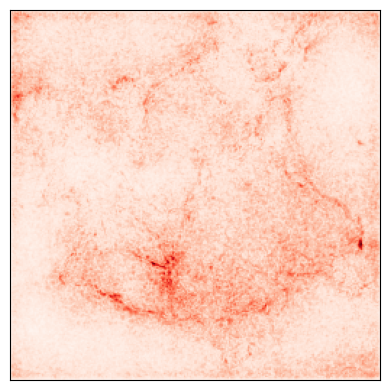

In [25]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing import image
from tensorflow.keras import backend as K
from tf_keras_vis.saliency import Saliency
from tf_keras_vis.utils import normalize
from vis.utils import utils

#loading the image and converting it to numpy array
img = tf.keras.preprocessing.image.load_img('C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png',target_size=(256,256))
x = img_to_array(img)  # Numpy array with shape (300, 300, 3)
x = x.reshape((1,) + x.shape)  # Numpy array with shape (1, 300, 300, 3)

# swap last layer with linear layer 
layer_idx = utils.find_layer_idx(model, model.layers[-1].name)
model.layers[-1].activation = tf.keras.activations.linear
model = utils.apply_modifications(model)

from tf_keras_vis.utils.scores import CategoricalScore
score = CategoricalScore([0])

#Create Saliency object
saliency = Saliency(model, clone=False)

subplot_args = {
   'nrows': 1,
   'ncols': 1,
   'figsize': (5, 4),
   'subplot_kw': {'xticks': [], 'yticks': []}
}

# Generate saliency map
saliency_map = saliency(score, x, smooth_samples=20, smooth_noise=0.2)
saliency_map = normalize(saliency_map)

f, ax = plt.subplots(**subplot_args)
ax.imshow(saliency_map[0], cmap='Reds')
plt.tight_layout()
plt.show()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16_input (InputLayer)    [(None, 256, 256, 3)]     0         
                                                                 
 vgg16 (Functional)          (None, 8, 8, 512)         14714688  
                                                                 
 flatten_1 (Flatten)         (None, 32768)             0         
                                                                 
Total params: 14,714,688
Trainable params: 0
Non-trainable params: 14,714,688
_________________________________________________________________
1/1 [==============================] - 9s 9s/step


IndexError: too many indices for array: array is 2-dimensional, but 4 were indexed

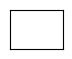

In [29]:
# plot feature map of first conv layer for given image

from keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims
# load the model
# redefine model to output right after the first hidden layer
model = Model(inputs=model.inputs, outputs=model.layers[1].output)
model.summary()
# load the image with the required shape
img = load_img('C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png', target_size=(256, 256))
# convert the image to an array
img = img_to_array(img)
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot all 64 maps in an 8x8 squares
square = 8
ix = 1
for _ in range(square):
	for _ in range(square):
		# specify subplot and turn of axis
		ax = pyplot.subplot(square, square, ix)
		ax.set_xticks([])
		ax.set_yticks([])
		# plot filter channel in grayscale
		pyplot.imshow(feature_maps[0, :, :, ix-1], cmap='gray')
		#pyplot.imshow(feature_maps[0, :, :, ix-1])
		ix += 1
# show the figure
pyplot.show()

In [31]:
# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims
# load the model
# redefine model to output right after the first hidden layer
ixs = [2, 5, 9, 13, 17]
outputs = [model.layers[i].output for i in ixs]
model = Model(inputs=model.inputs, outputs=outputs)
# load the image with the required shape
img = load_img('C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png', target_size=(256, 256))
# convert the image to an array
img = img_to_array(img)
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot the output from each block
square = 8
for fmap in feature_maps:
	# plot all 64 maps in an 8x8 squares
	ix = 1
	for _ in range(square):
		for _ in range(square):
			# specify subplot and turn of axis
			ax = pyplot.subplot(square, square, ix)
			ax.set_xticks([])
			ax.set_yticks([])
			# plot filter channel in grayscale
			pyplot.imshow(fmap[0, :, :, ix-1], cmap='gray')
            #pyplot.imshow(fmap[0, :, :, ix-1])
			ix += 1
	# show the figure
	pyplot.show()

IndexError: list index out of range

In [33]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
import os
import numpy as np
import matplotlib.pyplot as plt

#Iterate thru all the layers of the model
for layer in model.layers:
    if 'conv' in layer.name:
        weights, bias= layer.get_weights()
        print(layer.name, filters.shape)
        
        #normalize filter values between  0 and 1 for visualization
        f_min, f_max = weights.min(), weights.max()
        filters = (weights - f_min) / (f_max - f_min)  
        print(filters.shape[3])
        filter_cnt=1
        
        #plotting all the filters
        for i in range(filters.shape[3]):
            #get the filters
            filt=filters[:,:,:, i]
            #plotting each of the channel, color image RGB channels
            for j in range(filters.shape[0]):
                ax= plt.subplot(filters.shape[3], filters.shape[0], filter_cnt  )
                ax.set_xticks([])
                ax.set_yticks([])
                plt.imshow(filt[:,:, j])
                filter_cnt+=1
        plt.show()


In [34]:
img_path='C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png' #dog
# Define a new Model, Input= image 
# Output= intermediate representations for all layers in the  
# previous model after the first.
successive_outputs = [layer.output for layer in model.layers[1:]]
#visualization_model = Model(img_input, successive_outputs)
visualization_model = tf.keras.models.Model(inputs = model.input, outputs = successive_outputs)
#Load the input image
img = load_img(img_path, target_size=(150, 150))
# Convert ht image to Array of dimension (150,150,3)
x   = img_to_array(img)                           
x   = x.reshape((1,) + x.shape)
# Rescale by 1/255
x /= 255.0
# Let's run input image through our vislauization network
# to obtain all intermediate representations for the image.
successive_feature_maps = visualization_model.predict(x)
# Retrieve are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
   
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # We will tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x
# Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )

ValueError: Graph disconnected: cannot obtain value for tensor KerasTensor(type_spec=TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name='input_2'), name='input_2', description="created by layer 'input_2'") at layer "block1_conv1". The following previous layers were accessed without issue: []

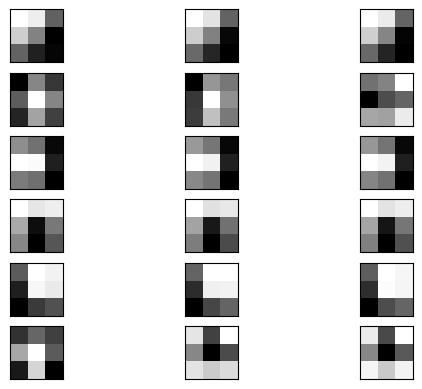

In [40]:
# retrieve weights from the second hidden layer
weights = model.layers[1].get_weights()[0]

# normalize filter values to 0-1 so we can visualize them
w_min, w_max = weights.min(), weights.max()
weights = (weights - w_min) / (w_max - w_min)

# plot first few filters
n_filters, ix = 6, 1
for i in range(n_filters):
    # get the filter
    w = weights[:, :, :, i]
    # plot each channel separately
    for j in range(3):
        # specify subplot and turn off axis
        ax = pyplot.subplot(n_filters, 3, ix)
        ax.set_xticks([])
        ax.set_yticks([])
        # plot filter channel in grayscale
        pyplot.imshow(w[:, :, j], cmap='gray')
        ix += 1

# show the figure
pyplot.show()


Model: "model_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
Total params: 1,792
Trainable params: 1,792
Non-trainable params: 0
_________________________________________________________________
1/1 [==============================] - 0s 179ms/step


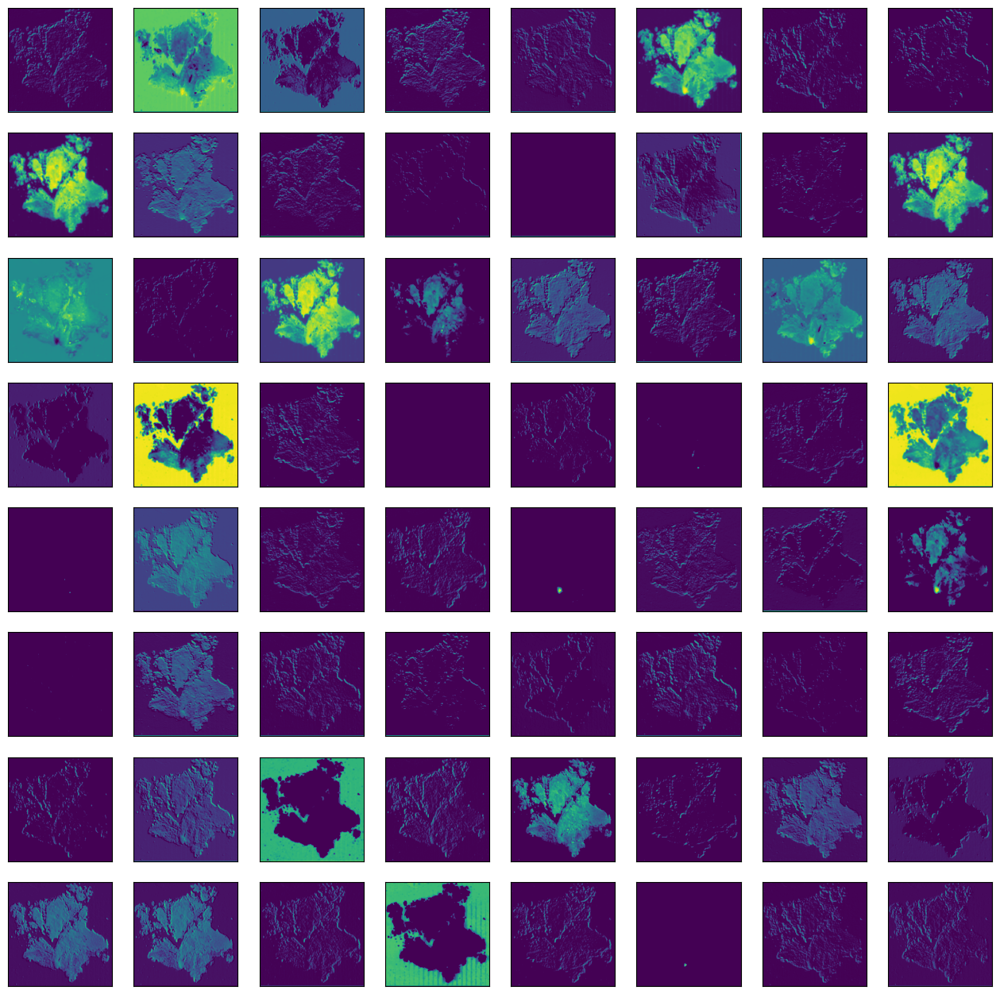

In [52]:
# plot feature map of first conv layer for given image
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.models import Model
from matplotlib import pyplot 
from numpy import expand_dims
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img


f = plt.figure(figsize=(16,16))
# load the modelf = plt.figure(figsize=(10,3))
model = VGG16()
# redefine model to output right after the first hidden layer
model = Model(inputs=model.inputs, outputs=model.layers[1].output)
model.summary()
# load the image with the required shape
img = load_img(f'C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png', target_size=(224, 224))
# convert the image to an array
img = img_to_array(img)
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot all 64 maps in an 8x8 squares
square = 8
ix = 1
for _ in range(square):
	for _ in range(square):
		# specify subplot and turn of axis
		ax = pyplot.subplot(square, square, ix)
		ax.set_xticks([])
		ax.set_yticks([])
		# plot filter channel in grayscale
		pyplot.imshow(feature_maps[0, :, :, ix-1], cmap='viridis')
		ix += 1
# show the figure
pyplot.show()

1/1 [==============================] - 3s 3s/step


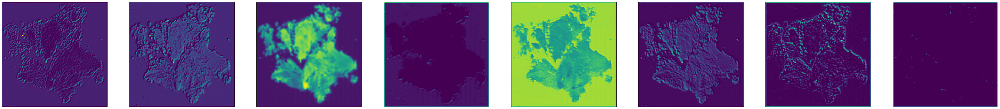

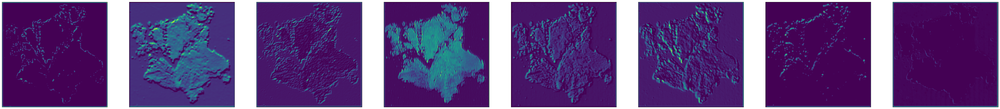

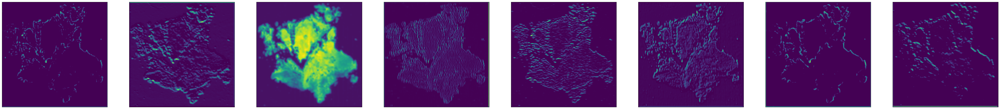

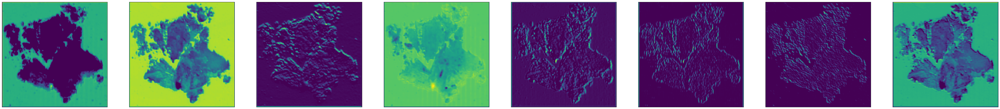

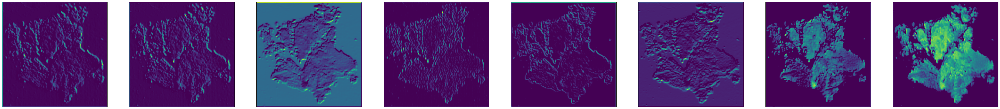

...

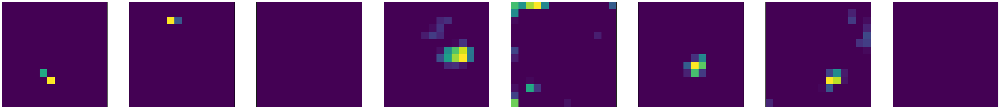

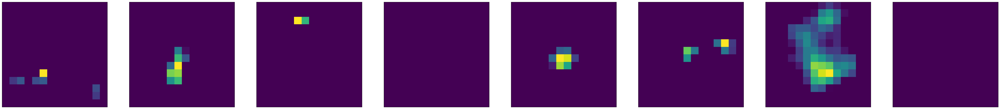

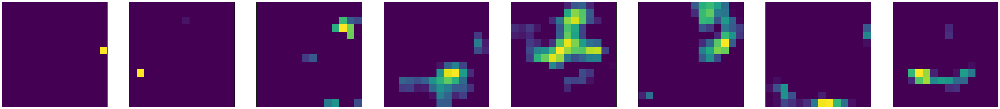

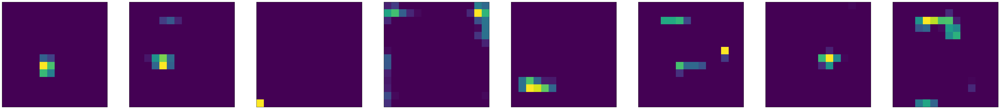

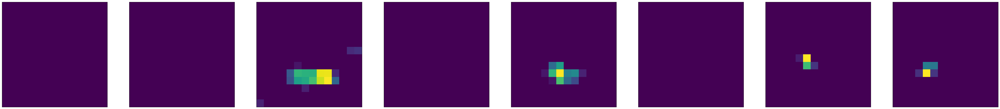

In [51]:
# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from keras.models import Model
import matplotlib.pyplot as plt
from numpy import expand_dims




# load the model
model = VGG16()
# redefine model to output right after the first hidden layer
ixs = [2, 5, 9, 13, 17]
outputs = [model.layers[i].output for i in ixs]
model = Model(inputs=model.inputs, outputs=outputs)
# load the image with the required shape
# convert the image to an array
img = load_img(f'C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png', target_size=(224, 224))
# convert the image to an array
img = img_to_array(img)
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot the output from each block
square = 8
for fmap in feature_maps:
	# plot all 64 maps in an 8x8 squares
	ix = 1
	for _ in range(square):
		plt.figure(figsize=(64,64))
		for _ in range(square):
           

			# specify subplot and turn of axis
			ax = pyplot.subplot(square, square, ix)
			ax.set_xticks([])
			ax.set_yticks([])
			
			# plot filter channel in grayscale
			plt.imshow(fmap[0, :, :, ix-1], cmap='viridis')
			ix += 1
	# show the figure

        
	plt.show()

  0%|                                                                                         | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 4s 4s/step


  1%|▊                                                                               | 10/1000 [00:04<07:15,  2.28it/s]

1/1 [==============================] - 4s 4s/step


  2%|█▌                                                                              | 20/1000 [00:08<06:58,  2.34it/s]

1/1 [==============================] - 3s 3s/step


  3%|██▍                                                                             | 30/1000 [00:12<06:31,  2.48it/s]

1/1 [==============================] - 4s 4s/step


  5%|███▊                                                                            | 48/1000 [00:19<05:48,  2.73it/s]

1/1 [==============================] - 4s 4s/step


  5%|████                                                                            | 51/1000 [00:23<07:57,  1.99it/s]

1/1 [==============================] - 3s 3s/step


  6%|████▊                                                                           | 60/1000 [00:27<07:40,  2.04it/s]

1/1 [==============================] - 3s 3s/step


  7%|█████▌                                                                          | 70/1000 [00:31<07:01,  2.21it/s]

1/1 [==============================] - 4s 4s/step


  8%|██████▍                                                                         | 80/1000 [00:35<06:43,  2.28it/s]

1/1 [==============================] - 3s 3s/step


  9%|███████▏                                                                        | 90/1000 [00:39<06:08,  2.47it/s]

1/1 [==============================] - 3s 3s/step


 10%|███████▉                                                                       | 100/1000 [00:42<05:53,  2.55it/s]

1/1 [==============================] - 3s 3s/step


 11%|████████▋                                                                      | 110/1000 [00:46<05:36,  2.65it/s]

1/1 [==============================] - 3s 3s/step


 12%|█████████▍                                                                     | 120/1000 [00:50<05:50,  2.51it/s]

1/1 [==============================] - 3s 3s/step


 13%|██████████▎                                                                    | 130/1000 [00:54<05:50,  2.48it/s]

1/1 [==============================] - 3s 3s/step


 14%|███████████                                                                    | 140/1000 [00:58<05:39,  2.53it/s]

1/1 [==============================] - 3s 3s/step


 15%|███████████▊                                                                   | 150/1000 [01:03<05:53,  2.41it/s]

1/1 [==============================] - 3s 3s/step


 16%|████████████▋                                                                  | 160/1000 [01:07<05:41,  2.46it/s]

1/1 [==============================] - 3s 3s/step


 17%|█████████████▍                                                                 | 170/1000 [01:11<05:36,  2.47it/s]

1/1 [==============================] - 3s 3s/step


 18%|██████████████▏                                                                | 180/1000 [01:15<05:40,  2.41it/s]

1/1 [==============================] - 3s 3s/step


 19%|███████████████                                                                | 190/1000 [01:19<05:38,  2.40it/s]

1/1 [==============================] - 3s 3s/step


 20%|███████████████▊                                                               | 200/1000 [01:23<05:31,  2.41it/s]

1/1 [==============================] - 3s 3s/step


 21%|████████████████▌                                                              | 210/1000 [01:27<05:11,  2.54it/s]

1/1 [==============================] - 3s 3s/step


 22%|█████████████████▍                                                             | 220/1000 [01:30<04:55,  2.64it/s]

1/1 [==============================] - 3s 3s/step


 23%|██████████████████▏                                                            | 230/1000 [01:34<04:50,  2.65it/s]

1/1 [==============================] - 3s 3s/step


 24%|██████████████████▉                                                            | 240/1000 [01:38<04:46,  2.65it/s]

1/1 [==============================] - 3s 3s/step


 25%|███████████████████▊                                                           | 250/1000 [01:41<04:36,  2.71it/s]

1/1 [==============================] - 3s 3s/step


 26%|████████████████████▌                                                          | 260/1000 [01:45<04:31,  2.72it/s]

1/1 [==============================] - 3s 3s/step


 27%|█████████████████████▎                                                         | 270/1000 [01:48<04:25,  2.75it/s]

1/1 [==============================] - 3s 3s/step


 28%|██████████████████████                                                         | 280/1000 [01:52<04:18,  2.78it/s]

1/1 [==============================] - 3s 3s/step


 29%|██████████████████████▉                                                        | 290/1000 [01:56<04:15,  2.78it/s]

1/1 [==============================] - 3s 3s/step


 30%|███████████████████████▋                                                       | 300/1000 [01:59<04:13,  2.76it/s]

1/1 [==============================] - 3s 3s/step


 31%|████████████████████████▍                                                      | 310/1000 [02:03<04:04,  2.82it/s]

1/1 [==============================] - 3s 3s/step


 32%|█████████████████████████▎                                                     | 320/1000 [02:06<03:57,  2.86it/s]

1/1 [==============================] - 3s 3s/step


 33%|██████████████████████████                                                     | 330/1000 [02:09<03:53,  2.87it/s]

1/1 [==============================] - 3s 3s/step


 34%|██████████████████████████▊                                                    | 340/1000 [02:13<03:49,  2.88it/s]

1/1 [==============================] - 3s 3s/step


 35%|███████████████████████████▋                                                   | 350/1000 [02:16<03:45,  2.88it/s]

1/1 [==============================] - 3s 3s/step


 36%|████████████████████████████▍                                                  | 360/1000 [02:20<03:42,  2.88it/s]

1/1 [==============================] - 3s 3s/step


 37%|█████████████████████████████▏                                                 | 370/1000 [02:23<03:39,  2.87it/s]

1/1 [==============================] - 3s 3s/step


 38%|██████████████████████████████                                                 | 380/1000 [02:27<03:36,  2.86it/s]

1/1 [==============================] - 3s 3s/step


 39%|██████████████████████████████▊                                                | 390/1000 [02:30<03:32,  2.87it/s]

1/1 [==============================] - 3s 3s/step


 40%|███████████████████████████████▌                                               | 400/1000 [02:34<03:28,  2.88it/s]

1/1 [==============================] - 3s 3s/step


 41%|████████████████████████████████▍                                              | 410/1000 [02:37<03:24,  2.88it/s]

1/1 [==============================] - 3s 3s/step


 42%|█████████████████████████████████▏                                             | 420/1000 [02:41<03:20,  2.90it/s]

1/1 [==============================] - 3s 3s/step


 43%|█████████████████████████████████▉                                             | 430/1000 [02:44<03:15,  2.92it/s]

1/1 [==============================] - 3s 3s/step


 44%|██████████████████████████████████▊                                            | 440/1000 [02:47<03:13,  2.90it/s]

1/1 [==============================] - 3s 3s/step


 45%|███████████████████████████████████▌                                           | 450/1000 [02:51<03:10,  2.89it/s]

1/1 [==============================] - 3s 3s/step


 46%|████████████████████████████████████▎                                          | 460/1000 [02:54<03:06,  2.90it/s]

1/1 [==============================] - 3s 3s/step


 47%|█████████████████████████████████████▏                                         | 470/1000 [02:58<03:02,  2.90it/s]

1/1 [==============================] - 3s 3s/step


 48%|█████████████████████████████████████▉                                         | 480/1000 [03:01<02:57,  2.93it/s]

1/1 [==============================] - 3s 3s/step


 49%|██████████████████████████████████████▋                                        | 490/1000 [03:05<02:56,  2.89it/s]

1/1 [==============================] - 3s 3s/step


 50%|███████████████████████████████████████▌                                       | 500/1000 [03:08<02:52,  2.89it/s]

1/1 [==============================] - 3s 3s/step


 51%|████████████████████████████████████████▎                                      | 510/1000 [03:12<02:48,  2.90it/s]

1/1 [==============================] - 3s 3s/step


 52%|█████████████████████████████████████████                                      | 520/1000 [03:15<02:43,  2.93it/s]

1/1 [==============================] - 3s 3s/step


 53%|█████████████████████████████████████████▊                                     | 530/1000 [03:18<02:40,  2.93it/s]

1/1 [==============================] - 3s 3s/step


 54%|██████████████████████████████████████████▋                                    | 540/1000 [03:22<02:36,  2.95it/s]

1/1 [==============================] - 3s 3s/step


 55%|███████████████████████████████████████████▍                                   | 550/1000 [03:25<02:33,  2.94it/s]

1/1 [==============================] - 3s 3s/step


 56%|████████████████████████████████████████████▏                                  | 560/1000 [03:29<02:30,  2.93it/s]

1/1 [==============================] - 3s 3s/step


 57%|█████████████████████████████████████████████                                  | 570/1000 [03:32<02:26,  2.93it/s]

1/1 [==============================] - 3s 3s/step


 58%|█████████████████████████████████████████████▊                                 | 580/1000 [03:35<02:24,  2.90it/s]

1/1 [==============================] - 3s 3s/step


 59%|██████████████████████████████████████████████▌                                | 590/1000 [03:39<02:20,  2.92it/s]

1/1 [==============================] - 3s 3s/step


 60%|███████████████████████████████████████████████▍                               | 600/1000 [03:42<02:16,  2.93it/s]

1/1 [==============================] - 3s 3s/step


 61%|████████████████████████████████████████████████▏                              | 610/1000 [03:46<02:12,  2.94it/s]

1/1 [==============================] - 3s 3s/step


 62%|████████████████████████████████████████████████▉                              | 620/1000 [03:49<02:09,  2.93it/s]

1/1 [==============================] - 3s 3s/step


 63%|█████████████████████████████████████████████████▊                             | 630/1000 [03:52<02:05,  2.94it/s]

1/1 [==============================] - 3s 3s/step


 64%|██████████████████████████████████████████████████▌                            | 640/1000 [03:56<02:02,  2.94it/s]

1/1 [==============================] - 3s 3s/step


 65%|███████████████████████████████████████████████████▎                           | 650/1000 [03:59<01:58,  2.94it/s]

1/1 [==============================] - 3s 3s/step


 66%|████████████████████████████████████████████████████▏                          | 660/1000 [04:03<01:56,  2.93it/s]

1/1 [==============================] - 3s 3s/step


 67%|████████████████████████████████████████████████████▉                          | 670/1000 [04:06<01:53,  2.91it/s]

1/1 [==============================] - 3s 3s/step


 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [04:10<01:49,  2.92it/s]

1/1 [==============================] - 3s 3s/step


 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [04:13<01:46,  2.91it/s]

1/1 [==============================] - 3s 3s/step


 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [04:16<01:42,  2.93it/s]

1/1 [==============================] - 3s 3s/step


 71%|████████████████████████████████████████████████████████                       | 710/1000 [04:20<01:38,  2.95it/s]

1/1 [==============================] - 3s 3s/step


 72%|████████████████████████████████████████████████████████▉                      | 720/1000 [04:23<01:36,  2.91it/s]

1/1 [==============================] - 3s 3s/step


 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [04:27<01:33,  2.90it/s]

1/1 [==============================] - 3s 3s/step


 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [04:30<01:29,  2.91it/s]

1/1 [==============================] - 3s 3s/step


 75%|███████████████████████████████████████████████████████████▎                   | 750/1000 [04:34<01:26,  2.90it/s]

1/1 [==============================] - 3s 3s/step


 76%|████████████████████████████████████████████████████████████                   | 760/1000 [04:37<01:23,  2.86it/s]

1/1 [==============================] - 3s 3s/step


 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [04:41<01:19,  2.88it/s]

1/1 [==============================] - 3s 3s/step


 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [04:44<01:16,  2.89it/s]

1/1 [==============================] - 3s 3s/step


 79%|██████████████████████████████████████████████████████████████▍                | 790/1000 [04:48<01:12,  2.88it/s]

1/1 [==============================] - 3s 3s/step


 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [04:51<01:11,  2.82it/s]

1/1 [==============================] - 3s 3s/step


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [04:55<01:08,  2.77it/s]

1/1 [==============================] - 3s 3s/step


 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [04:58<01:03,  2.81it/s]

1/1 [==============================] - 3s 3s/step


 83%|█████████████████████████████████████████████████████████████████▌             | 830/1000 [05:02<01:00,  2.80it/s]

1/1 [==============================] - 3s 3s/step


 84%|██████████████████████████████████████████████████████████████████▎            | 840/1000 [05:06<00:56,  2.81it/s]

1/1 [==============================] - 3s 3s/step


 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [05:09<00:53,  2.81it/s]

1/1 [==============================] - 3s 3s/step


 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [05:13<00:49,  2.82it/s]

1/1 [==============================] - 3s 3s/step


 87%|████████████████████████████████████████████████████████████████████▋          | 870/1000 [05:16<00:45,  2.83it/s]

1/1 [==============================] - 3s 3s/step


 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [05:20<00:42,  2.82it/s]

1/1 [==============================] - 3s 3s/step


 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [05:23<00:39,  2.80it/s]

1/1 [==============================] - 3s 3s/step


 90%|███████████████████████████████████████████████████████████████████████        | 900/1000 [05:27<00:35,  2.81it/s]

1/1 [==============================] - 3s 3s/step


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [05:31<00:32,  2.78it/s]

1/1 [==============================] - 3s 3s/step


 92%|████████████████████████████████████████████████████████████████████████▋      | 920/1000 [05:34<00:28,  2.79it/s]

1/1 [==============================] - 3s 3s/step


 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [05:38<00:25,  2.70it/s]

1/1 [==============================] - 3s 3s/step


 94%|██████████████████████████████████████████████████████████████████████████▎    | 940/1000 [05:42<00:22,  2.68it/s]

1/1 [==============================] - 3s 3s/step


 95%|███████████████████████████████████████████████████████████████████████████    | 950/1000 [05:45<00:18,  2.73it/s]

1/1 [==============================] - 3s 3s/step


 96%|███████████████████████████████████████████████████████████████████████████▊   | 960/1000 [05:49<00:14,  2.74it/s]

1/1 [==============================] - 3s 3s/step


 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [05:53<00:10,  2.77it/s]

1/1 [==============================] - 3s 3s/step


 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [05:56<00:07,  2.78it/s]

1/1 [==============================] - 3s 3s/step


 99%|██████████████████████████████████████████████████████████████████████████████▏| 990/1000 [06:00<00:03,  2.81it/s]

1/1 [==============================] - 3s 3s/step


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [06:03<00:00,  2.75it/s]


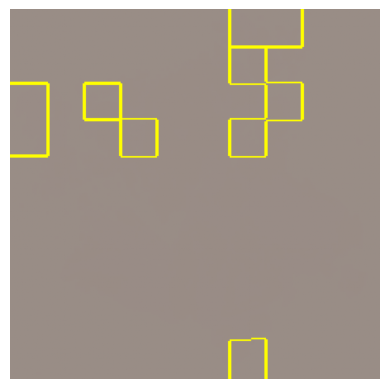

In [90]:

import numpy as np
import skimage.io
import skimage.segmentation
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import VGG16
from lime import lime_image
from lime.wrappers.scikit_image import SegmentationAlgorithm
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Load the pre-trained VGG16 model
model = VGG16(weights='imagenet')

# Preprocess image
def preprocess_image(img):
    img = skimage.img_as_float(img)
    img = skimage.transform.resize(img, (224, 224))  # Resize to VGG16 input size
    img = preprocess_input(img)
    img = np.expand_dims(img, axis=0)
    return img

# Create superpixels using SLIC algorithm
def superpixel_segmentation(image):
    img = skimage.transform.resize(image, (224, 224))  # Resize image
    segments = skimage.segmentation.slic(img, n_segments=100, compactness=0.1)
    segments = skimage.transform.resize(segments, (224, 224))  # Resize segments to match image size
    segments = segments.astype(int)  # Convert segments to integer data type
    return segments


# Define the prediction function for Model
def predict_fn(images):
    preprocessed_images = [preprocess_image(img) for img in images]
    preprocessed_images = np.vstack(preprocessed_images)
    predictions = model.predict(preprocessed_images)
    return predictions

# Lime explanation using superpixels
def explain_with_lime(image):
    # Preprocess the image
    preprocessed_img = preprocess_image(image)

    # Create superpixels
    segments = superpixel_segmentation(image)

    # Create Lime explainer
    explainer = lime_image.LimeImageExplainer()

    # Create Lime explanation
    explanation = explainer.explain_instance(preprocessed_img[0], predict_fn, top_labels=5, num_samples=1000,
                                             segmentation_fn=SegmentationAlgorithm('slic', n_segments=100))

    # Get the explanation for the predicted label
    _, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10,
                                             hide_rest=False, min_weight=0.0)

    # Overlay the explanation on the original image
    segmented_img = mark_boundaries(preprocessed_img[0].astype(np.uint8), segments)
    expl_img = mark_boundaries(segmented_img, mask)

    return expl_img

# Load and process the input image
img_path = 'C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png'
input_image = skimage.io.imread(img_path)

explanation_image = explain_with_lime(input_image)

# Display the explanation image
plt.imshow(explanation_image)
plt.axis('off')
plt.show()


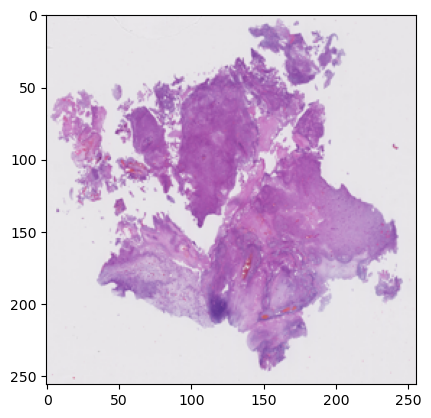

In [91]:
img_path = 'C:\\Users\\Maximilian\\Desktop\\data\\256x256\\Glioblastoma, IDH-wildtype\\a194f783-357f-11eb-9ee2-001a7dda7111.png'
input_image = skimage.io.imread(img_path)
plt.imshow(input_image)


In [19]:
#using VGG16 with model evaluation



# Step 1: Data Collection and Preparation
data_directory = '/content/drive/MyDrive/256x256'  # Replace with the actual path to your dataset folder
image_size = (256, 256)  # Set the desired image size
X = []
y = []


class_names = []  # Initialize an empty list for class names

for class_index, class_name in enumerate(sorted(os.listdir(data_directory))):
    class_directory = os.path.join(data_directory, class_name)
    if not os.path.isdir(class_directory):  # Skip non-directory items
        continue
    class_names.append(class_name)  # Append the class name to the list
    for image_file in os.listdir(class_directory):
        image_path = os.path.join(class_directory, image_file)
        if not os.path.isfile(image_path):  # Skip non-file items
            continue
        try:
            image = Image.open(image_path).convert('RGB')
            image = image.resize(image_size)
            X.append(np.array(image))
            y.append(class_index)
        except Exception as e:
            print(f"Error processing image: {image_path}")
            print(e)
# Step 2: Preprocessing
X = np.array(X)
y = np.array(y)

# Step 3: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Create and Configure Image Data Generator
data_generator = ImageDataGenerator(
    rescale=1.0 / 255.0,
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    vertical_flip=True
)

# Step 5: Load the pre-trained VGG16 model without the top classification layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(image_size[0], image_size[1], 3))

# Freeze the weights of the base model
base_model.trainable = False

# Step 6: Build the model architecture on top of the base model
model = Sequential()
model.add(base_model)
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Step 7: Model Training using Image Data Generator
batch_size = 8
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)

early_stopping = EarlyStopping(monitor='val_loss', patience=3)  # Early stopping to prevent overfitting

history = model.fit(train_generator, epochs=30, steps_per_epoch=len(X_train) // batch_size,
                    validation_data=test_generator, validation_steps=len(X_test) // batch_size,
                    callbacks=[early_stopping])

# Model Evaluation
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

print("Classification Report:")
print(classification_report(y_test, y_pred_classes, target_names=class_names))

print("Confusion Matrix:")
cm = confusion_matrix(y_test, y_pred_classes)
print(cm)

# Plotting training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plotting training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


FileNotFoundError: [WinError 3] Das System kann den angegebenen Pfad nicht finden: '/content/drive/MyDrive/256x256'

20/20 [==============================] - 1s 44ms/step
Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        22
           1       0.00      0.00      0.00         8
           2       0.00      0.00      0.00        15
           3       0.00      0.00      0.00        11
           4       0.00      0.00      0.00         1
           5       0.00      0.00      0.00        10
           6       0.00      0.00      0.00        24
           9       0.00      0.00      0.00         3
          11       0.00      0.00      0.00         4
          12       0.00      0.00      0.00         1
          13       0.00      0.00      0.00        22
          14       0.00      0.00      0.00         3
          16       0.00      0.00      0.00         9
          17       0.00      0.00      0.00         4
          18       0.00      0.00      0.00         3
          19       0.00      0.00      0.00         3
    

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


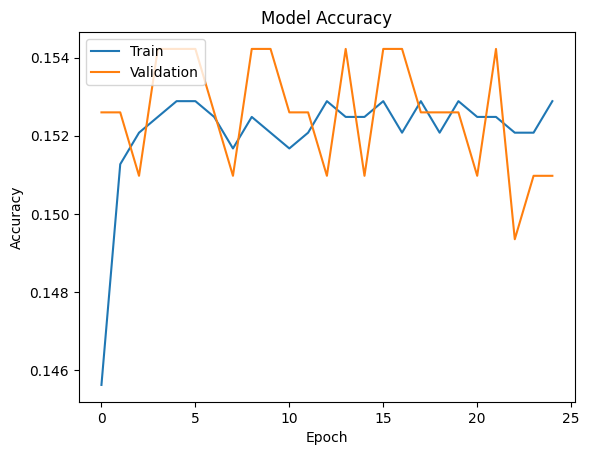

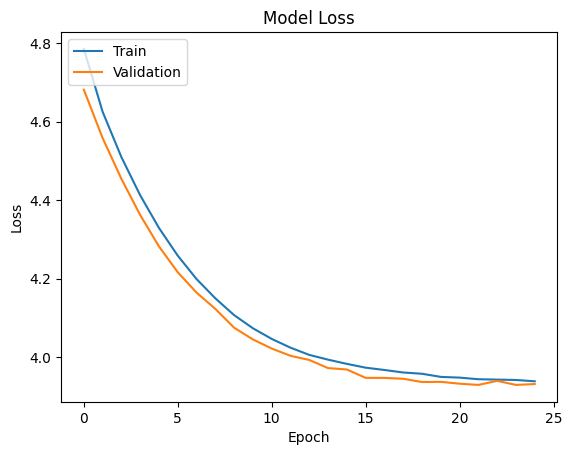

In [ ]:

# Step 5: Model Evaluation
y_pred_classes = np.argmax(model.predict(X_test), axis=1)
labels = sorted(set(y_test))  # Get the unique classes from y_test

print("Classification Report:")
print(classification_report(y_test, y_pred_classes, labels=labels))

print("Confusion Matrix:")
confusion_mat = confusion_matrix(y_test, y_pred_classes, labels=labels)
confusion_df = pd.DataFrame(confusion_mat, index=labels, columns=labels)
print(confusion_df)


# Plotting training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plotting training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


Epoch 1/30
249/249 [==============================] - 150s 561ms/step - loss: 4.9333 - accuracy: 0.1787 - val_loss: 4.6825 - val_accuracy: 0.1754
Epoch 2/30
249/249 [==============================] - 134s 538ms/step - loss: 4.6142 - accuracy: 0.1938 - val_loss: 4.5446 - val_accuracy: 0.1734
Epoch 3/30
249/249 [==============================] - 127s 511ms/step - loss: 4.5013 - accuracy: 0.1938 - val_loss: 4.4209 - val_accuracy: 0.1734
Epoch 4/30
249/249 [==============================] - 132s 528ms/step - loss: 4.3675 - accuracy: 0.1938 - val_loss: 4.3112 - val_accuracy: 0.1754
Epoch 5/30
249/249 [==============================] - 135s 542ms/step - loss: 4.2631 - accuracy: 0.1948 - val_loss: 4.2131 - val_accuracy: 0.1754
Epoch 6/30
249/249 [==============================] - 134s 537ms/step - loss: 4.1727 - accuracy: 0.1938 - val_loss: 4.1267 - val_accuracy: 0.1754
Epoch 7/30
249/249 [==============================] - 135s 541ms/step - loss: 4.0928 - accuracy: 0.1938 - val_loss: 4.0548 -

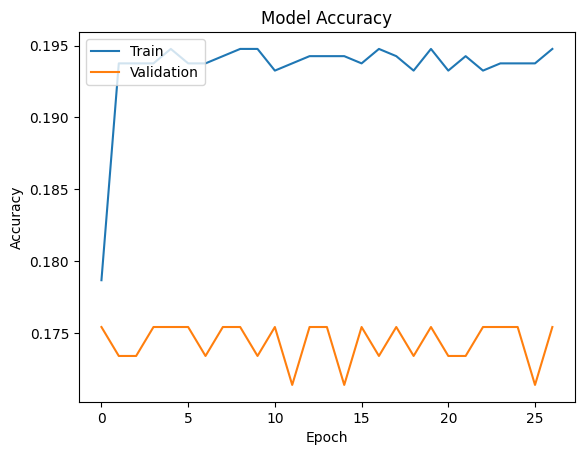

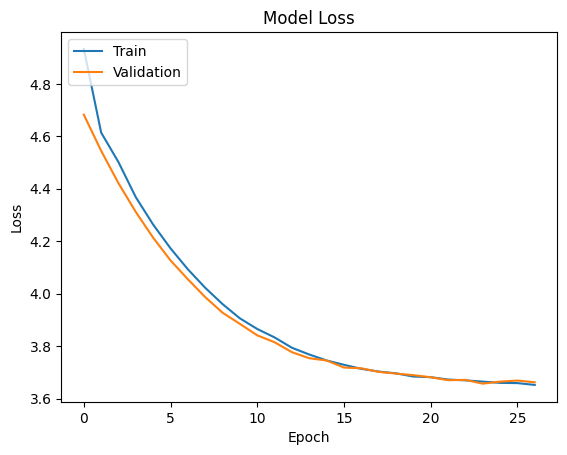

In [ ]:
# using VGG16 on 512x512

# Step 1: Data Collection and Preparation
data_directory = '/content/drive/MyDrive/512x512'  # Replace with the actual path to your dataset folder
image_size = (512,512)  # Set the desired image size
X = []
y = []

class_names = sorted(os.listdir(data_directory))
num_classes = len(class_names)

for class_index, class_name in enumerate(class_names):
    class_directory = os.path.join(data_directory, class_name)
    if not os.path.isdir(class_directory):  # Skip non-directory items
        continue
    for image_file in os.listdir(class_directory):
        image_path = os.path.join(class_directory, image_file)
        if not os.path.isfile(image_path):  # Skip non-file items
            continue
        try:
            image = Image.open(image_path).convert('RGB')
            image = image.resize(image_size)
            X.append(np.array(image))
            y.append(class_index)
        except Exception as e:
            print(f"Error processing image: {image_path}")
            print(e)

# Step 2: Preprocessing
X = np.array(X)
y = np.array(y)

# Step 3: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Create and Configure Image Data Generator
data_generator = ImageDataGenerator(
    rescale=1.0 / 255.0,
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    vertical_flip=True
)

# Step 5: Load the pre-trained VGG16 model without the top classification layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(image_size[0], image_size[1], 3))

# Freeze the weights of the base model
base_model.trainable = False

# Step 6: Build the model architecture on top of the base model
model = Sequential()
model.add(base_model)
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Step 7: Model Training using Image Data Generator
batch_size = 8
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)

early_stopping = EarlyStopping(monitor='val_loss', patience=3)  # Early stopping to prevent overfitting

history = model.fit(train_generator, epochs=30, steps_per_epoch=len(X_train) // batch_size,
                    validation_data=test_generator, validation_steps=len(X_test) // batch_size,
                    callbacks=[early_stopping])

# Plotting training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plotting training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


Epoch 1/30
52/52 [==============================] - 27s 488ms/step - loss: 6.5673 - accuracy: 0.8822 - val_loss: 0.7760 - val_accuracy: 0.8942
Epoch 2/30
52/52 [==============================] - 25s 480ms/step - loss: 0.4320 - accuracy: 0.9159 - val_loss: 0.3551 - val_accuracy: 0.8942
Epoch 3/30
52/52 [==============================] - 25s 480ms/step - loss: 0.3713 - accuracy: 0.9159 - val_loss: 0.3477 - val_accuracy: 0.8942
Epoch 4/30
52/52 [==============================] - 25s 489ms/step - loss: 0.3402 - accuracy: 0.9159 - val_loss: 0.3511 - val_accuracy: 0.8942
Epoch 5/30
52/52 [==============================] - 25s 481ms/step - loss: 0.3370 - accuracy: 0.9159 - val_loss: 0.3440 - val_accuracy: 0.8942
Epoch 6/30
52/52 [==============================] - 25s 482ms/step - loss: 0.4329 - accuracy: 0.9159 - val_loss: 0.4185 - val_accuracy: 0.8942
Epoch 7/30
52/52 [==============================] - 25s 487ms/step - loss: 0.3486 - accuracy: 0.9159 - val_loss: 0.3596 - val_accuracy: 0.8942

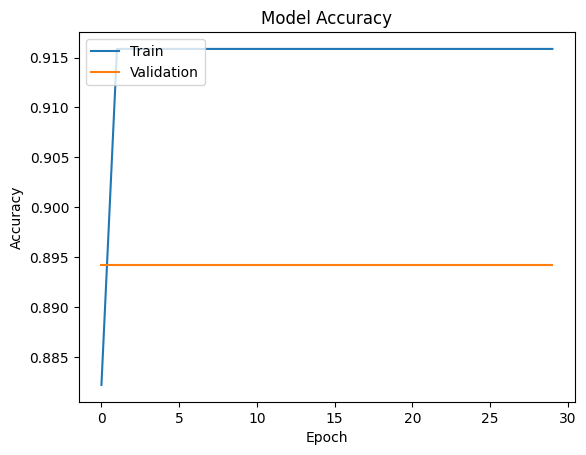

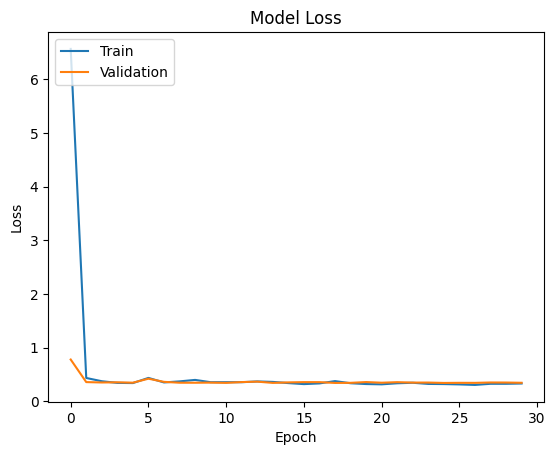

In [ ]:
#using CNN for two tumours -512x512

# Step 1: Data Collection and Preparation
data_directory = '/content/drive/MyDrive/512x512_twotumours'  # Replace with the actual path to your dataset folder
image_size = (512, 512)  # Set the desired image size
X = []
y = []

class_names = sorted(os.listdir(data_directory))
num_classes = len(class_names)

for class_index, class_name in enumerate(class_names):
    class_directory = os.path.join(data_directory, class_name)
    if not os.path.isdir(class_directory):  # Skip non-directory items
        continue
    for image_file in os.listdir(class_directory):
        image_path = os.path.join(class_directory, image_file)
        if not os.path.isfile(image_path):  # Skip non-file items
            continue
        try:
            image = Image.open(image_path).convert('RGB')
            image = image.resize(image_size)
            X.append(np.array(image))
            y.append(class_index)
        except Exception as e:
            print(f"Error processing image: {image_path}")
            print(e)

# Step 2: Preprocessing
X = np.array(X)
y = np.array(y)

# Step 3: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Create and Configure Image Data Generator
data_generator = ImageDataGenerator(
    rescale=1.0 / 255.0,
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    vertical_flip=True
)

# Step 5: Model Creation
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(image_size[0], image_size[1], 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))  # Adding Dropout regularization
model.add(Dense(num_classes, activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Step 6: Model Training using Image Data Generator
batch_size = 8
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)

early_stopping = EarlyStopping(monitor='val_loss', patience=18)  # Early stopping to prevent overfitting

history = model.fit(train_generator, epochs=30, steps_per_epoch=len(X_train) // batch_size,
                    validation_data=test_generator, validation_steps=len(X_test) // batch_size,
                    callbacks=[early_stopping])

# Plotting training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plotting training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Epoch 1/30
52/52 [==============================] - 28s 517ms/step - loss: 3.7072 - accuracy: 0.8341 - val_loss: 0.4960 - val_accuracy: 0.8942
Epoch 2/30
52/52 [==============================] - 27s 519ms/step - loss: 0.4487 - accuracy: 0.8942 - val_loss: 1.7310 - val_accuracy: 0.8942
Epoch 3/30
52/52 [==============================] - 27s 522ms/step - loss: 0.7918 - accuracy: 0.9159 - val_loss: 0.3543 - val_accuracy: 0.8942
Epoch 4/30
52/52 [==============================] - 27s 522ms/step - loss: 0.3872 - accuracy: 0.9159 - val_loss: 0.3620 - val_accuracy: 0.8942
Epoch 5/30
52/52 [==============================] - 27s 518ms/step - loss: 0.3575 - accuracy: 0.9159 - val_loss: 0.3425 - val_accuracy: 0.8942
Epoch 6/30
52/52 [==============================] - 26s 510ms/step - loss: 0.3853 - accuracy: 0.9159 - val_loss: 0.4085 - val_accuracy: 0.8942
Epoch 7/30
52/52 [==============================] - 27s 525ms/step - loss: 0.3548 - accuracy: 0.9159 - val_loss: 0.3764 - val_accuracy: 0.8942

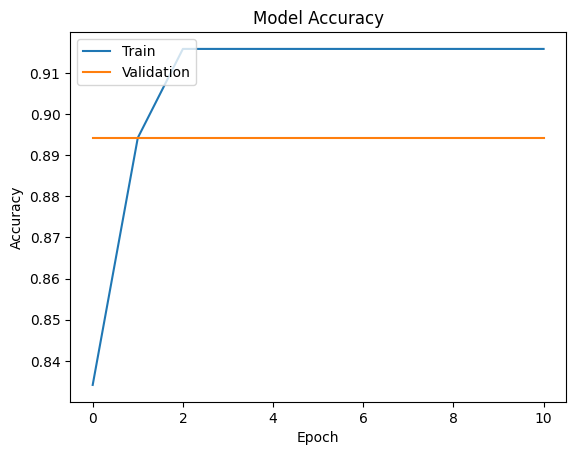

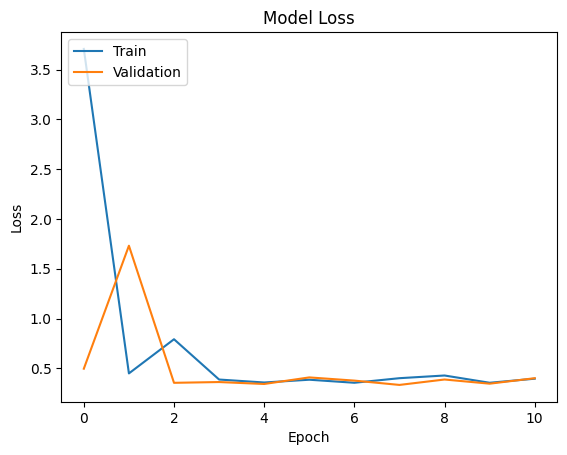

In [ ]:
# using VGG16 on Two tumors -512x512

# Step 1: Data Collection and Preparation
data_directory = '/content/drive/MyDrive/512x512_twotumours'  # Replace with the actual path to your dataset folder
image_size = (512,512)  # Set the desired image size
X = []
y = []

class_names = sorted(os.listdir(data_directory))
num_classes = len(class_names)

for class_index, class_name in enumerate(class_names):
    class_directory = os.path.join(data_directory, class_name)
    if not os.path.isdir(class_directory):  # Skip non-directory items
        continue
    for image_file in os.listdir(class_directory):
        image_path = os.path.join(class_directory, image_file)
        if not os.path.isfile(image_path):  # Skip non-file items
            continue
        try:
            image = Image.open(image_path).convert('RGB')
            image = image.resize(image_size)
            X.append(np.array(image))
            y.append(class_index)
        except Exception as e:
            print(f"Error processing image: {image_path}")
            print(e)

# Step 2: Preprocessing
X = np.array(X)
y = np.array(y)

# Step 3: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Create and Configure Image Data Generator
data_generator = ImageDataGenerator(
    rescale=1.0 / 255.0,
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    vertical_flip=True
)

# Step 5: Load the pre-trained VGG16 model without the top classification layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(image_size[0], image_size[1], 3))

# Freeze the weights of the base model
base_model.trainable = False

# Step 6: Build the model architecture on top of the base model
model = Sequential()
model.add(base_model)
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Step 7: Model Training using Image Data Generator
batch_size = 8
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)

early_stopping = EarlyStopping(monitor='val_loss', patience=3)  # Early stopping to prevent overfitting

history = model.fit(train_generator, epochs=30, steps_per_epoch=len(X_train) // batch_size,
                    validation_data=test_generator, validation_steps=len(X_test) // batch_size,
                    callbacks=[early_stopping])

# Plotting training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plotting training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


Epoch 1/30
52/52 [==============================] - 11s 177ms/step - loss: 1.4126 - accuracy: 0.9038 - val_loss: 0.4949 - val_accuracy: 0.8942
Epoch 2/30
52/52 [==============================] - 8s 164ms/step - loss: 0.4158 - accuracy: 0.9159 - val_loss: 0.4688 - val_accuracy: 0.8942
Epoch 3/30
52/52 [==============================] - 7s 131ms/step - loss: 0.3540 - accuracy: 0.9159 - val_loss: 0.3453 - val_accuracy: 0.8942
Epoch 4/30
52/52 [==============================] - 7s 133ms/step - loss: 0.3158 - accuracy: 0.9159 - val_loss: 0.3453 - val_accuracy: 0.8942
Epoch 5/30
52/52 [==============================] - 7s 128ms/step - loss: 0.3717 - accuracy: 0.9159 - val_loss: 0.3666 - val_accuracy: 0.8942
Epoch 6/30
52/52 [==============================] - 7s 129ms/step - loss: 0.3345 - accuracy: 0.9159 - val_loss: 0.3667 - val_accuracy: 0.8942
Epoch 7/30
52/52 [==============================] - 7s 128ms/step - loss: 0.3364 - accuracy: 0.9159 - val_loss: 0.3643 - val_accuracy: 0.8942


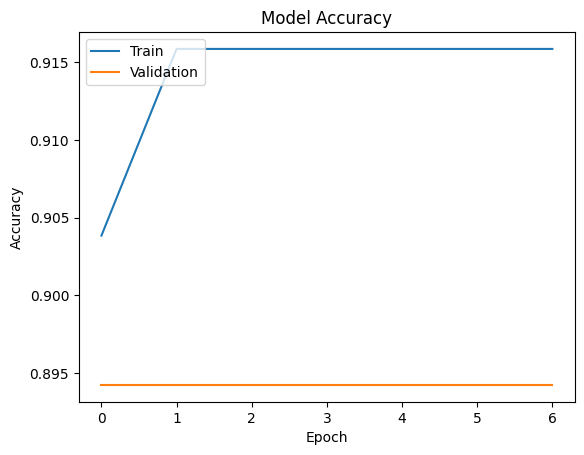

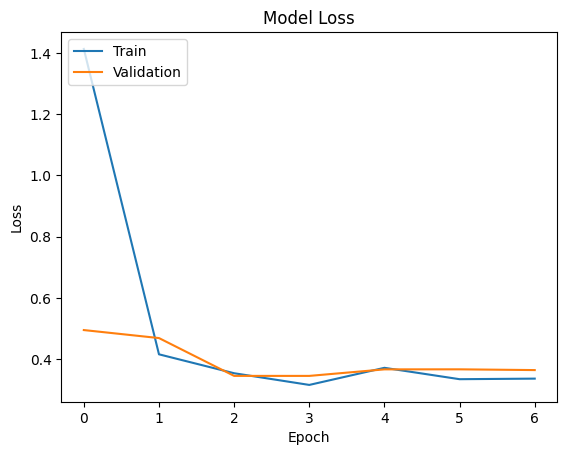

In [ ]:
#using CNN for two tumours -256x256

# Step 1: Data Collection and Preparation
data_directory = '/content/drive/MyDrive/256x256_twotumors'  # Replace with the actual path to your dataset folder
image_size = (256,256)  # Set the desired image size
X = []
y = []

class_names = sorted(os.listdir(data_directory))
num_classes = len(class_names)

for class_index, class_name in enumerate(class_names):
    class_directory = os.path.join(data_directory, class_name)
    if not os.path.isdir(class_directory):  # Skip non-directory items
        continue
    for image_file in os.listdir(class_directory):
        image_path = os.path.join(class_directory, image_file)
        if not os.path.isfile(image_path):  # Skip non-file items
            continue
        try:
            image = Image.open(image_path).convert('RGB')
            image = image.resize(image_size)
            X.append(np.array(image))
            y.append(class_index)
        except Exception as e:
            print(f"Error processing image: {image_path}")
            print(e)

# Step 2: Preprocessing
X = np.array(X)
y = np.array(y)

# Step 3: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Create and Configure Image Data Generator
data_generator = ImageDataGenerator(
    rescale=1.0 / 255.0,
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    vertical_flip=True
)

# Step 5: Model Creation
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(image_size[0], image_size[1], 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))  # Adding Dropout regularization
model.add(Dense(num_classes, activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Step 6: Model Training using Image Data Generator
batch_size = 8
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)

early_stopping = EarlyStopping(monitor='val_loss', patience=3)  # Early stopping to prevent overfitting

history = model.fit(train_generator, epochs=30, steps_per_epoch=len(X_train) // batch_size,
                    validation_data=test_generator, validation_steps=len(X_test) // batch_size,
                    callbacks=[early_stopping])

# Plotting training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plotting training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

Epoch 1/30
52/52 [==============================] - 9s 133ms/step - loss: 0.9768 - accuracy: 0.8486 - val_loss: 0.3660 - val_accuracy: 0.8942
Epoch 2/30
52/52 [==============================] - 7s 133ms/step - loss: 0.4482 - accuracy: 0.9159 - val_loss: 0.3425 - val_accuracy: 0.8942
Epoch 3/30
52/52 [==============================] - 7s 130ms/step - loss: 0.4039 - accuracy: 0.9159 - val_loss: 0.3247 - val_accuracy: 0.8942
Epoch 4/30
52/52 [==============================] - 7s 132ms/step - loss: 0.3808 - accuracy: 0.9159 - val_loss: 0.3195 - val_accuracy: 0.8942
Epoch 5/30
52/52 [==============================] - 7s 132ms/step - loss: 0.3497 - accuracy: 0.9159 - val_loss: 0.3291 - val_accuracy: 0.8942
Epoch 6/30
52/52 [==============================] - 7s 129ms/step - loss: 0.3762 - accuracy: 0.9159 - val_loss: 0.3150 - val_accuracy: 0.8942
Epoch 7/30
52/52 [==============================] - 7s 132ms/step - loss: 0.3011 - accuracy: 0.9159 - val_loss: 0.3067 - val_accuracy: 0.8942
Epoch 

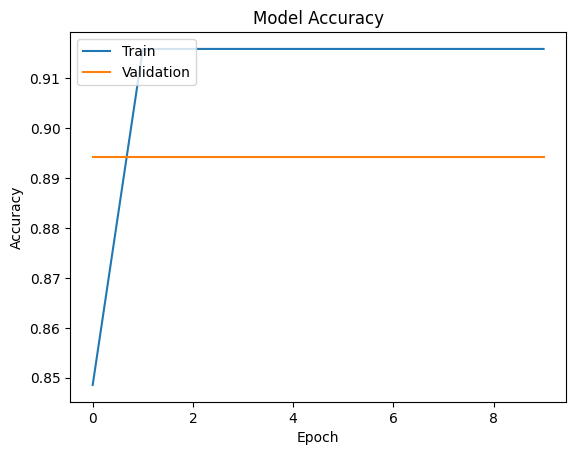

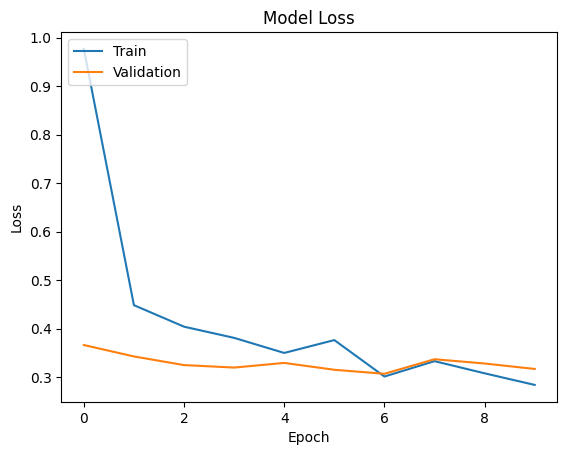

In [ ]:
# using VGG16 on Two tumors -256x256

# Step 1: Data Collection and Preparation
data_directory = '/content/drive/MyDrive/256x256_twotumors'  # Replace with the actual path to your dataset folder
image_size = (256,256)  # Set the desired image size
X = []
y = []

class_names = sorted(os.listdir(data_directory))
num_classes = len(class_names)

for class_index, class_name in enumerate(class_names):
    class_directory = os.path.join(data_directory, class_name)
    if not os.path.isdir(class_directory):  # Skip non-directory items
        continue
    for image_file in os.listdir(class_directory):
        image_path = os.path.join(class_directory, image_file)
        if not os.path.isfile(image_path):  # Skip non-file items
            continue
        try:
            image = Image.open(image_path).convert('RGB')
            image = image.resize(image_size)
            X.append(np.array(image))
            y.append(class_index)
        except Exception as e:
            print(f"Error processing image: {image_path}")
            print(e)

# Step 2: Preprocessing
X = np.array(X)
y = np.array(y)

# Step 3: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Create and Configure Image Data Generator
data_generator = ImageDataGenerator(
    rescale=1.0 / 255.0,
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    vertical_flip=True
)

# Step 5: Load the pre-trained VGG16 model without the top classification layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(image_size[0], image_size[1], 3))

# Freeze the weights of the base model
base_model.trainable = False

# Step 6: Build the model architecture on top of the base model
model = Sequential()
model.add(base_model)
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Step 7: Model Training using Image Data Generator
batch_size = 8
train_generator = data_generator.flow(X_train, y_train, batch_size=batch_size)
test_generator = data_generator.flow(X_test, y_test, batch_size=batch_size)

early_stopping = EarlyStopping(monitor='val_loss', patience=3)  # Early stopping to prevent overfitting

history = model.fit(train_generator, epochs=30, steps_per_epoch=len(X_train) // batch_size,
                    validation_data=test_generator, validation_steps=len(X_test) // batch_size,
                    callbacks=[early_stopping])

# Plotting training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plotting training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()
